In [1]:
from utils_luke import to_standard_units, formatter, rodrigues
import os
os.chdir("../")
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation as R
from godot.core import tempo, astro, events
from godot.core.autodif import bridge as br
from godot import cosmos
from godot.model import eventgen, common, prop
import godot.core.util as util
util.suppressLogger()

In [2]:
f=open("HaloOrbit/GateWayOrbit_prop.csv","r")
lines=f.readlines()
print(lines[0])
lines = lines[1:]
f.close()
print(lines)
lines = [[float(element) for element in line.strip().split(",")] for line in lines]
#change to seconds and km
HaloData = np.array([[to_standard_units(line[0], "TU"), to_standard_units(line[1], "LU"), to_standard_units(line[2], "LU"), to_standard_units(line[3], "LU")] for line in lines])
print(HaloData[0:10])
print(HaloData[-1][0]/(24*3600))
print(HaloData)

Time (TU),X (LU),Y (LU),Z (LU),VX (LU/TU),VY (LU/TU),VZ (LU/TU)

['0,1.0196625817475922,3.4173862952063685e-27,-0.18041918731575562,-1.8760072461303471e-13,-0.09805982467069076,-3.0285607115934284e-12\n', '0.004010237096860553,1.0196615668828732,-0.0003932384985572269,-0.18041507352681013,-0.0005061365158997318,-0.09805634751719534,0.0020516512947649818\n', '0.011768066340914464,1.0196538424806556,-0.001153857059821812,-0.18038376114026441,-0.001485238497001299,-0.09802987916796489,0.006020920611298277\n', '0.01953018371817065,1.0196385120317626,-0.0019145894250295159,-0.18032160955989404,-0.002464815683999552,-0.09797733325268698,0.0099933790447479\n', '0.02729736834630814,1.0196155609323667,-0.0026753087372417524,-0.18022854651613246,-0.0034449225927069478,-0.09789863039243761,0.01397008623820836\n', '0.035069810091897906,1.0195849744661956,-0.003435829253461096,-0.18010449271153467,-0.004425539021747235,-0.09779367603224275,0.017951806072684876\n', '0.04284771421733827,1.01954673742

In [3]:
uni_config=cosmos.util.load_yaml("universe2.yml")
uni = cosmos.Universe(uni_config)

ep1 = tempo.Epoch('2026-01-01T00:00:00 TT')
ep2 = tempo.Epoch('2026-04-01T00:00:00 TT')
ran = tempo.EpochRange( ep1, ep2 )
timestep=30.0
grid = ran.createGrid(timestep) # 60 seconds stepsize
eps = 1e-6
tol = 1e-6
print(len(grid))
print(ep2-ep1)
print(ep1-ep2)

259201
7776000.0
-7776000.0


In [4]:
uni_config=cosmos.util.load_yaml("universe2.yml")
uni = cosmos.Universe(uni_config)
frames = uni.frames
icrf = frames.axesId('ICRF')
moonPoint=frames.pointId('Moon')
earthPoint=frames.pointId('Earth')

moonData=np.asarray([frames.vector3(earthPoint, moonPoint, icrf, ep) for ep in grid])


move initial halo data to position on moon orbit

In [5]:
def rotation(point, axis, angle):
    v1=point*np.cos(angle)
    v2=np.cross(axis, point)*np.sin(angle)
    v3=axis*np.dot(axis, point)*(1-np.cos(angle))
    return v1+v2+v3

In [6]:
def rotation_matrix(moonPos, x_moon):
        # determine rotation matrix
        rot_axis= np.cross(moonPos, x_moon)
        rot_axis = rot_axis/np.linalg.norm(rot_axis)
        angle = -np.arccos(np.dot(x_moon, moonPos)/(np.linalg.norm(x_moon)*np.linalg.norm(moonPos)))
        R=np.array([[rot_axis[0]**2*(1-np.cos(angle))+np.cos(angle),                        rot_axis[0]*rot_axis[1]*(1-np.cos(angle))-rot_axis[2]*np.sin(angle),    rot_axis[0]*rot_axis[2]*(1-np.cos(angle))+rot_axis[1]*np.sin(angle)],
                    [rot_axis[0]*rot_axis[1]*(1-np.cos(angle))+rot_axis[2]*np.sin(angle),   rot_axis[1]**2*(1-np.cos(angle))+np.cos(angle),                         rot_axis[1]*rot_axis[2]*(1-np.cos(angle))-rot_axis[0]*np.sin(angle)],
                    [rot_axis[0]*rot_axis[2]*(1-np.cos(angle))-rot_axis[1]*np.sin(angle),   rot_axis[1]*rot_axis[2]*(1-np.cos(angle))+rot_axis[0]*np.sin(angle),    rot_axis[2]**2*(1-np.cos(angle))+np.cos(angle)]])
        return R

Find lunar orbit plane

In [7]:
from sklearn.decomposition import PCA
pca=PCA(n_components=3)
pca.fit(moonData)
rot_axis=pca.components_[2]
rot_axis /= np.linalg.norm(rot_axis)
print(pca.singular_values_)

[1.40338845e+08 1.35603575e+08 1.79469529e+05]


get initial point and project to lunar orbit plane

In [8]:
x_moon=np.array([to_standard_units(1, "LU"), 0, 0])
# x_moon=np.array([1, 0, 0])
moon_index=np.argmin([np.linalg.norm(moonPos-x_moon) for moonPos in moonData])
init_moonPoint=moonData[8000]
print(moonData[moon_index])
#project to plane
Proj=np.eye(3)-np.outer(rot_axis,rot_axis)
init_moonPoint=Proj@init_moonPoint

[379577.45405264  -6151.77417433  10685.98047357]


move halo orbit to be initially on lunar orbit plane

In [9]:
init_axis=np.cross(init_moonPoint, x_moon)
init_angle=np.dot(x_moon, init_moonPoint)/(np.linalg.norm(init_moonPoint)*np.linalg.norm(x_moon))
init_angle=np.arccos(init_angle)
print(init_angle)
moon_len=np.linalg.norm(init_moonPoint)

1.8838994414071522


In [10]:
from mpl_toolkits.mplot3d import Axes3D

In [11]:
new_HaloData=np.zeros((len(HaloData), 3))
Rot_mat=rotation_matrix(init_moonPoint, x_moon)
for i, HaloPos in enumerate(HaloData):
    pos=Rot_mat@HaloPos[1:]
    new_HaloData[i]=pos

new_HaloData=np.insert(new_HaloData.T, 0, HaloData.T[0], axis=0).T

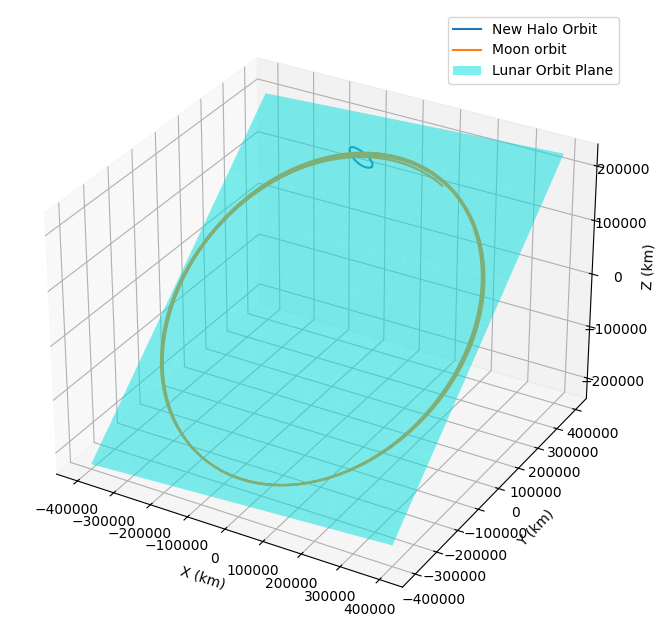

In [12]:
# %matplotlib widget
%matplotlib inline
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*new_HaloData.T[1:], label='New Halo Orbit')
ax.plot(*moonData.T, label='Moon orbit')

# Plot the plane for rot_axis
xx, yy = np.meshgrid(np.linspace(-400000, 400000, 10), np.linspace(-400000, 400000, 10))
z = (-rot_axis[0] * xx - rot_axis[1] * yy) / rot_axis[2]
ax.plot_surface(xx, yy, z, alpha=0.5, color='cyan', label='Lunar Orbit Plane')

ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()

plt.show()


Create emphimeris

In [13]:
from scipy.linalg import expm
def closest_time(time, orbits, HaloOrbitTime, HaloData):
    tempTime = time - orbits * HaloOrbitTime
    if tempTime < 0:
        raise ValueError("Time is less than 0")
    return np.abs(tempTime-HaloData[:,0]).argmin()

def epoch_to_seconds(epoch, epoch0):
    return epoch - epoch0

def inPlane_rotationmatrix(rot_axis):
    # return np.cross(rot_axis, np.eye(3))
    L=np.array([[0, -rot_axis[2], rot_axis[1]],
                    [rot_axis[2], 0, -rot_axis[0]],
                    [-rot_axis[1], rot_axis[0], 0]])
    return L

def find_angle(init_moonPoint, moonPos, rot_axis):
    # angle=-np.arccos(np.dot(init_moonPoint/np.linalg.norm(init_moonPoint), moonPos/np.linalg.norm(moonPos))/(np.linalg.norm(init_moonPoint)*np.linalg.norm(moonPos)))
    angle=-np.arccos(np.dot(init_moonPoint, moonPos)/(np.linalg.norm(init_moonPoint)*np.linalg.norm(moonPos)))
    sign=np.sign(np.dot(np.cross(init_moonPoint, moonPos), rot_axis)) # possibly remove this
    return sign*angle
    # return angle

def inplane_rotation_matrix(rot_mat, angle, init_point):
    return  np.array(expm(angle*rot_mat)) @ init_point 

def rotation_matrix_new(moonPos, x_moon, rot_axis, angle):
        # determine rotation matrix
        R=np.array([[rot_axis[0]**2*(1-np.cos(angle))+np.cos(angle),                        rot_axis[0]*rot_axis[1]*(1-np.cos(angle))-rot_axis[2]*np.sin(angle),    rot_axis[0]*rot_axis[2]*(1-np.cos(angle))+rot_axis[1]*np.sin(angle)],
                    [rot_axis[0]*rot_axis[1]*(1-np.cos(angle))+rot_axis[2]*np.sin(angle),   rot_axis[1]**2*(1-np.cos(angle))+np.cos(angle),                         rot_axis[1]*rot_axis[2]*(1-np.cos(angle))-rot_axis[0]*np.sin(angle)],
                    [rot_axis[0]*rot_axis[2]*(1-np.cos(angle))-rot_axis[1]*np.sin(angle),   rot_axis[1]*rot_axis[2]*(1-np.cos(angle))+rot_axis[0]*np.sin(angle),    rot_axis[2]**2*(1-np.cos(angle))+np.cos(angle)]])
        return R

In [14]:
emph=np.zeros((len(grid), 3))
projected_moon=np.zeros((len(grid), 3))
epoch0=grid[0]
HaloOrbitTime=new_HaloData[-1][0]
inAxis_rot_mat=inPlane_rotationmatrix(rot_axis)
for i, ep in enumerate(grid):
    # print(i)
    time=epoch_to_seconds(ep, epoch0)
    orbits=np.floor(time/HaloOrbitTime)
    HaloOrbitPos=np.array(new_HaloData[closest_time(time, orbits, HaloOrbitTime, new_HaloData)])
    HaloOrbitPos=HaloOrbitPos[1:]
    HaloOrbitLen = np.linalg.norm(x_moon- HaloOrbitPos)
    
    moonPos=np.array(moonData[i])
    moon_len=np.linalg.norm(moonPos)
    Proj=np.eye(3)-np.outer(rot_axis,rot_axis) #project to plane
    moonPos=Proj@moonPos
    projected_moon[i]=moonPos

    angle=find_angle(init_moonPoint, moonPos, rot_axis)
    # angle=chat_angle(rot_axis, moonPos, init_moonPoint)
    # rotation_mat=inplane_rotation_matrix(inAxis_rot_mat, angle, init_moonPoint)
    rotation_mat=rotation_matrix_new(moonPos, init_moonPoint, rot_axis, angle)
    pos=HaloOrbitPos @ rotation_mat
    # emph[i]=(pos/np.linalg.norm(pos))*(moon_len+HaloOrbitLen)
    emph[i]=pos

write emphimeris as txt

In [15]:
import csv
filename="haloOrbit_emph.csv"
with open(filename, "w", newline='') as f:
    writer = csv.writer(f)
    writer.writerows(emph)
f.close()

In [16]:
with open(filename, newline='') as f:
    reader=csv.reader(f, delimiter=' ')
    for row in reader:
        print(','.join(row))
f.close()

188842.63153869435,337039.3587648923,116558.16961583807
188810.79901700027,337054.73934508575,116565.26329435185
188778.96485864764,337070.1174640653,116572.35558639976
188747.1290639145,337085.49312166346,116579.44649190201
188715.29163307924,337100.86631771293,116586.53601077877
188683.45256641973,337116.2370520462,116593.62414295031
188651.61186421468,337131.6053244957,116600.71088833678
188619.76952674234,337146.9711348941,116607.79624685847
188587.92555428063,337162.3344830741,116614.88021843566
188556.07994710843,337177.6953688683,116621.96280298861
188524.23270550382,337193.0537921094,116629.04400043766
188492.38382974532,337208.40975263005,116636.12381070308
188460.53332011128,337223.7632502631,116643.20223370522
188428.68117688035,337239.1142848412,116650.27926936437
188396.82740033092,337254.46285619726,116657.35491760094
188364.97199074144,337269.80896416405,116664.42917833531
188333.11494839046,337285.1526085745,116671.50205148789
188301.25627355662,337300.4937892612,116678

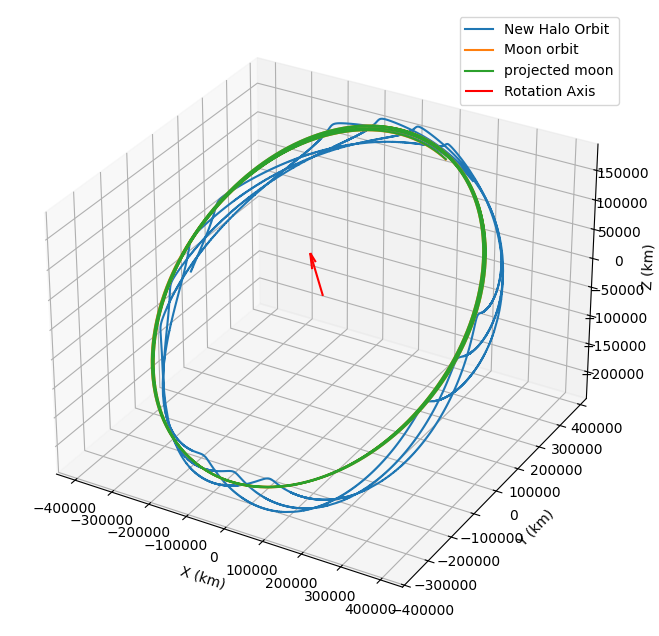

In [17]:
# %matplotlib widget
%matplotlib inline
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*emph.T, label='New Halo Orbit')
ax.plot(*moonData.T, label='Moon orbit')
ax.plot(*projected_moon.T, label='projected moon')
# Plot the rotation axis
ax.quiver(0, 0, 0, rot_axis[0], rot_axis[1], rot_axis[2], color='red', length=100000, label='Rotation Axis')
ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()


plt.show()

In [18]:
res = [np.linalg.norm(moonData[i]-projected_moon[i]) for i in range(len(moonData))]
print(np.max(res))

1029.528589330947


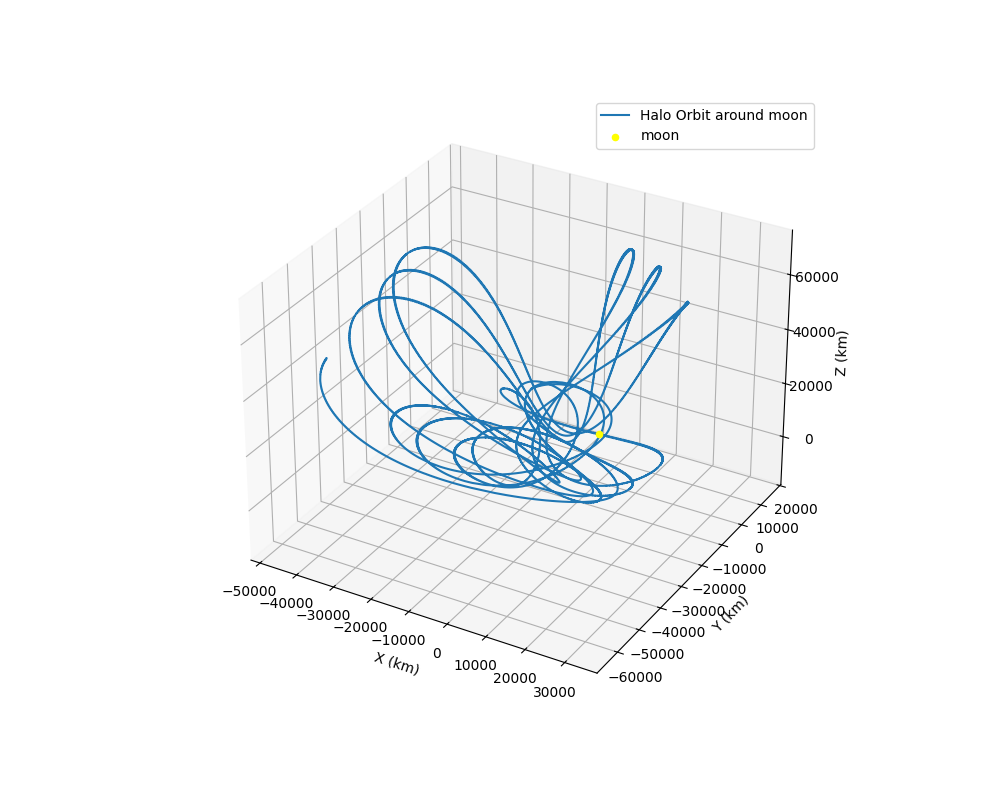

In [19]:
%matplotlib widget
orbit_moon_centered=moonData-emph

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*orbit_moon_centered.T, label='Halo Orbit around moon')
ax.scatter(0, 0, 0, color="yellow", label="moon")
ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()

plt.show()

[-44550.71766125 -47943.06601062  44506.71693083]
[-44549.0122612  -47946.8889533   44504.72197951]
[-44547.30634923 -47950.71164772  44502.72718099]
[-44545.5999254  -47954.53409381  44500.7325353 ]
[-44543.89298974 -47958.35629151  44498.73804249]
[-44542.18554232 -47962.17824074  44496.74370259]
[-44540.47758318 -47965.99994143  44494.74951563]
[-44538.76911237 -47969.82139352  44492.75548166]
[-44537.06012994 -47973.64259692  44490.7616007 ]
[-44535.35063594 -47977.46355158  44488.76787279]
[-44533.64063043 -47981.28425743  44486.77429797]
[-44531.93011344 -47985.10471438  44484.78087627]
[-44530.21908503 -47988.92492238  44482.78760773]
[-44528.50754526 -47992.74488135  44480.79449239]
[-44526.79549416 -47996.56459122  44478.80153028]
[-44525.0829318  -48000.38405193  44476.80872143]
[-44523.36985822 -48004.2032634   44474.81606589]
[-44521.65627346 -48008.02222556  44472.82356369]
[-44519.94217759 -48011.84093835  44470.83121486]
[-44518.22757065 -48015.65940169  44468.83901943]


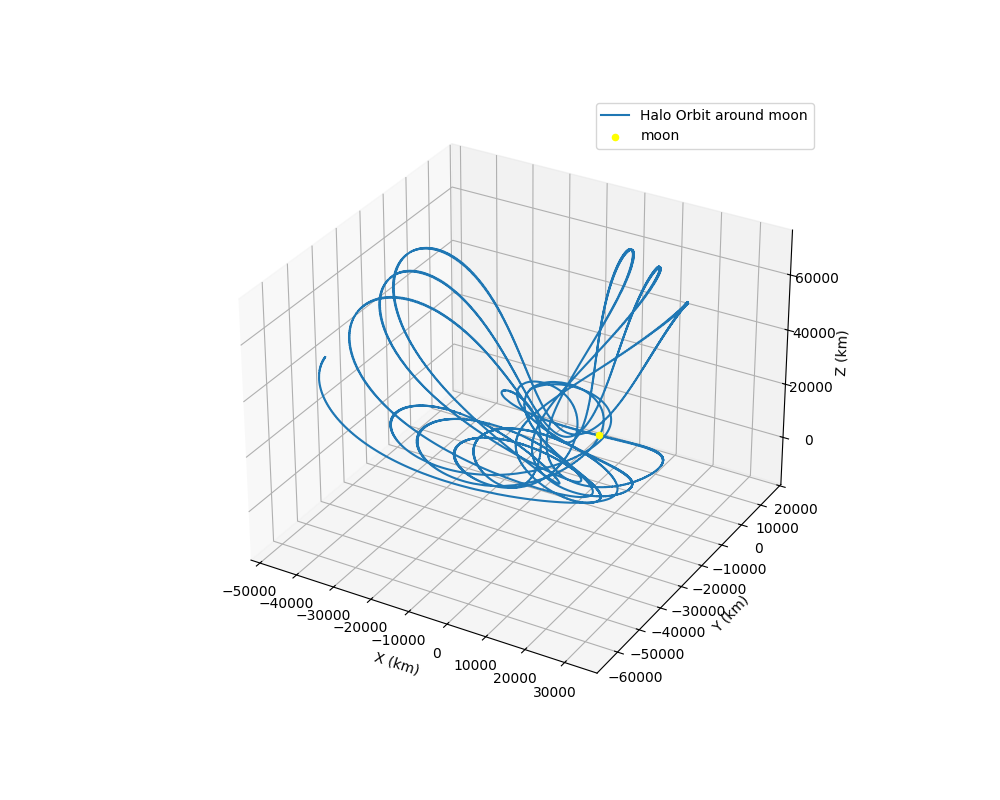

In [20]:
orbit_projMoon_centered=np.zeros((len(moonData), 3))
for i in range(len(moonData)):
    orbit_projMoon_centered[i]=projected_moon[i]-emph[i]
    print(projected_moon[i]-emph[i])
    
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*orbit_projMoon_centered.T, label='Halo Orbit around moon')
ax.scatter(0, 0, 0, color="yellow", label="moon")
ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()

plt.show()

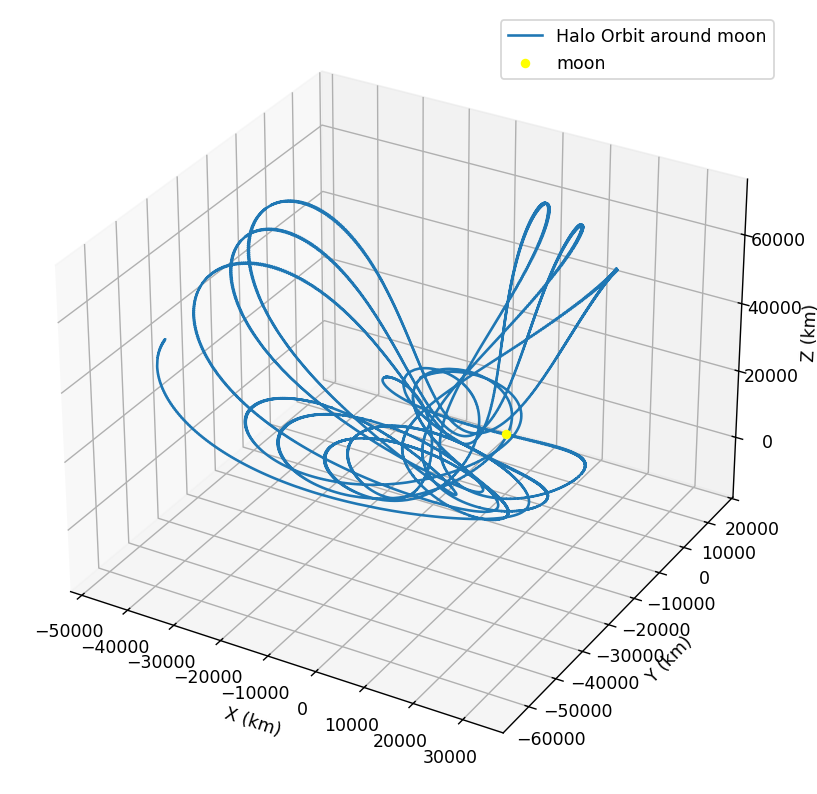

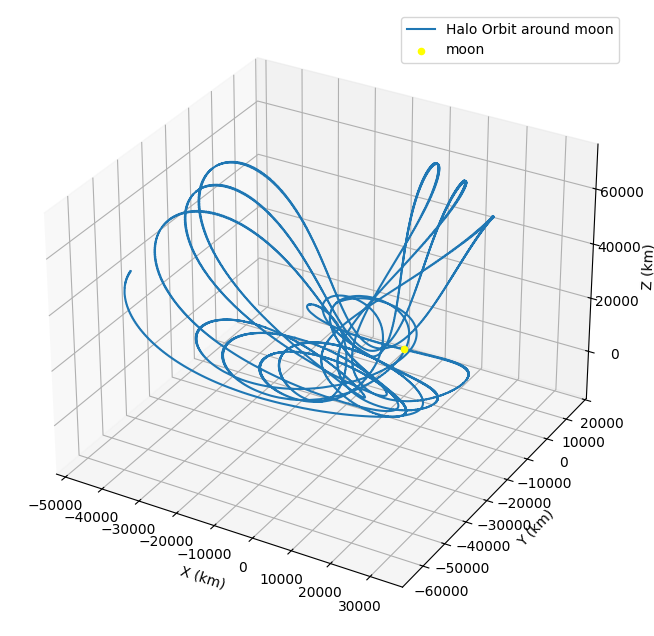

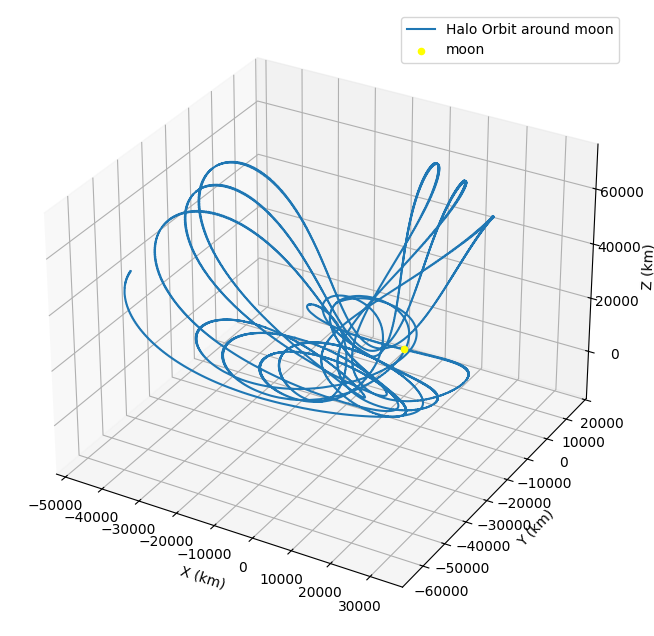

In [21]:
%matplotlib inline
orbit_projMoon_centered=projected_moon-emph

    
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*orbit_projMoon_centered.T, label='Halo Orbit around moon')
ax.scatter(0, 0, 0, color="yellow", label="moon")
ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()

plt.show()

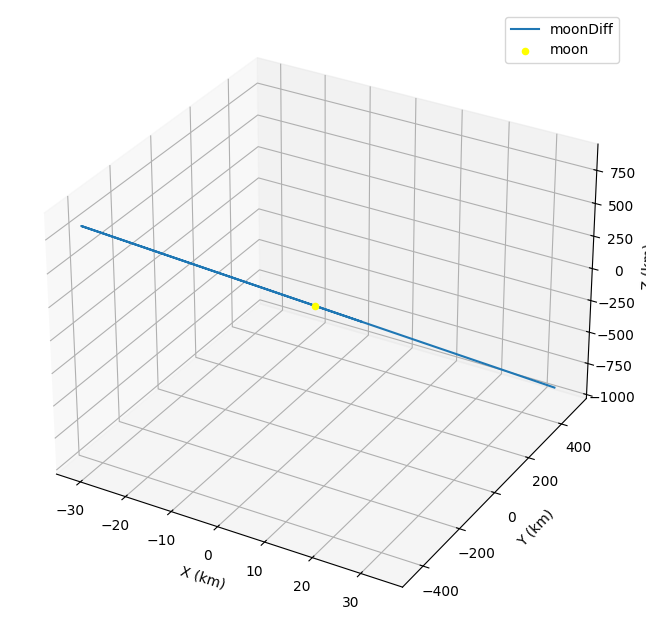

In [22]:
moonDiff=moonData-projected_moon


    
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the data
ax.plot(*moonDiff.T, label='moonDiff')
ax.scatter(0, 0, 0, color="yellow", label="moon")
ax.set_xlabel('X (km)')
ax.set_ylabel('Y (km)')
ax.set_zlabel('Z (km)')
ax.legend()

plt.show()